since this is purely for visualization, can take some liberties

In [1]:
import numpy as np

Nmesh = 128
snapno = 4

_fname = '/scratch/users/delon/LIMxCMBL/summary_plot/positions_snapno_%d.npy'%(snapno)
parts = np.load(_fname)


_fname = '/scratch/users/delon/LIMxCMBL/summary_plot/snapno_%d_matter_Nmesh_%d_cutout_value.npy'%(snapno, Nmesh)
df = np.load(_fname)


_fname = '/scratch/users/delon/LIMxCMBL/summary_plot/fg_Nmesh_%d.npy'%(Nmesh)
dfg = np.load(_fname)

In [2]:
import sys
import matplotlib.pyplot as plt

import pyccl as ccl
from LIMxCMBL.init import *
import h5py
import hdf5plugin
import types
from collections import defaultdict
from mpl_toolkits.mplot3d import Axes3D, art3d  # NOQA

In [3]:
import seaborn as sns

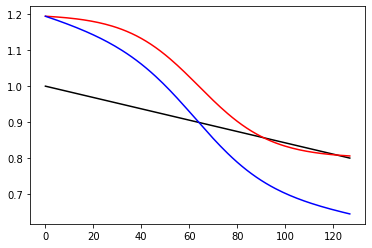

In [4]:
Dz = np.linspace(0.8, 1, Nmesh)[::-1]
WLIM = np.tanh(-((np.arange(Nmesh) - Nmesh/2)/30))/5 + 1

plt.plot(np.arange(Nmesh), Dz, c='k')
plt.plot(np.arange(Nmesh), WLIM, c='r')
plt.plot(np.arange(Nmesh), Dz*WLIM, c='b')

I will put in basically fake lightcone evolution

In [5]:
df = df[:,::-1, :]
delta = df - 1
print(np.min(delta), np.max(delta))
delta *= Dz.reshape(1, -1, 1)
print(np.min(delta), np.max(delta))

-1.0 808.1309
-1.0 805.58563


In [6]:
x, y, z = np.indices((Nmesh, Nmesh, Nmesh))

_x = x.flatten()
_y = y.flatten()
_z = z.flatten()

_center = Nmesh / 2
perp_length = int(Nmesh // 1.618 / 2)
filled = ((_x >=  _center - perp_length) 
          & (_x <=  _center + perp_length)
          & (_z >=  _center - perp_length)
          & (_z <=  _center + perp_length))
idxs = np.where(filled)


def _plot(colors, std=0.25, sz=0.25, nstd=6):

    fig = plt.figure(dpi=800)
    ax = fig.add_subplot(projection='3d')



    for i in range(1,nstd):
        __x = (_x + np.random.normal(scale = std/2, size = Nmesh**3))
        __y = (_y + np.random.normal(scale = std/2, size = Nmesh**3))
        __z = (_z + np.random.normal(scale = std/2, size = Nmesh**3))

        ax.scatter(__x[idxs],
                   __y[idxs],
                   __z[idxs], c = colors.reshape(Nmesh**3, 4)[idxs],
                   s=sz*i, lw=0, depthshade=False)


    _min = _center - perp_length
    _max = _center + perp_length + 1
    ax.set_xlim([_min, _max])
    ax.set_zlim([_min, _max])
    ax.set_ylim([0, Nmesh])

    edges_kw = dict(color='k', linewidth=3, zorder=1e3, solid_capstyle='round')
    #external
    ax.plot([_min, _max], [0, 0], _min, **edges_kw)
    ax.plot([_max,_max], [0, Nmesh], _min, **edges_kw)
    ax.plot([_min, _min], [0, 0], [_min, _max], **edges_kw)
    ax.plot([_min, _max], [Nmesh, Nmesh], _max, **edges_kw)
    ax.plot([_min, _min], [0, Nmesh],[_max, _max], **edges_kw)
    ax.plot([_max, _max], [Nmesh, Nmesh], [_min, _max], **edges_kw)


    edges_kw = dict(color='k', linewidth=1, zorder=1e3)
    #faceing us
    ax.plot([_max, _max], [0, Nmesh],[_max, _max], **edges_kw)
    ax.plot([_min, _max], [0, 0], _max, **edges_kw)
    ax.plot([_max, _max], [0, 0], [_min, _max], **edges_kw)

    edges_kw = dict(color='k', linewidth=0.5, zorder=1e3)
    #internal
    ax.plot([_min, _min], [0, Nmesh],[_min, _min], **edges_kw)
    ax.plot([_min, _max], [Nmesh, Nmesh], _min, **edges_kw)
    ax.plot([_min, _min], [Nmesh, Nmesh], [_min, _max], **edges_kw)


    ax.axis('off')
    #ax.set_xticks([])
    #ax.set_yticks([])
    #ax.set_zticks([])

    # ax.set_proj_type('persp', focal_length=0.3)


    xlim = ax.get_xlim3d()
    ylim = ax.get_ylim3d()
    zlim = ax.get_zlim3d()
    ax.set_box_aspect((xlim[1]-xlim[0], ylim[1]-ylim[0], zlim[1]-zlim[0]))

    ax.view_init(elev=25, azim=-40, roll=0)
    return fig,ax

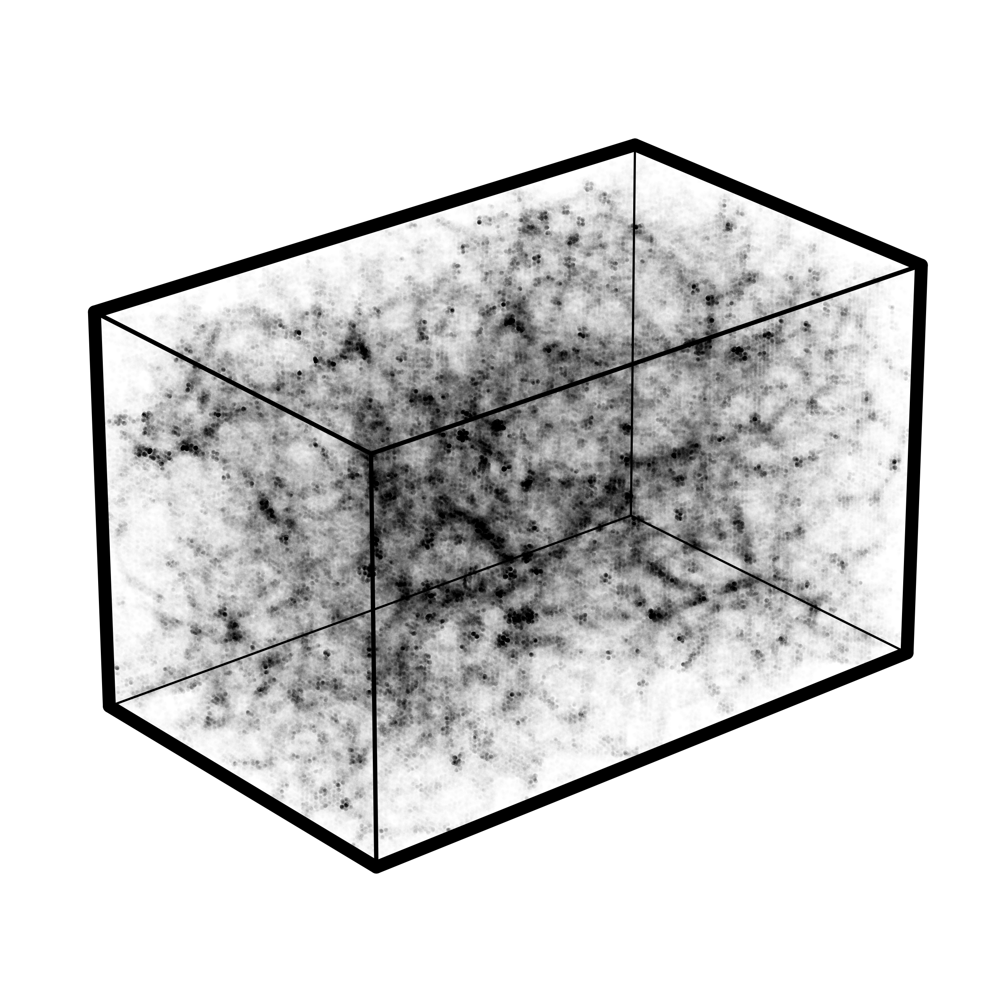

In [7]:
def alpha_transform(alpha):
#     return alpha**1.5
    return alpha

colors = np.zeros((Nmesh,Nmesh,Nmesh,)+ (4,))

denom = (np.max(df)/3)
alph = np.where(df / denom <= 1, df / denom, 1)

colors[...,3] = alpha_transform(alph)

fig, ax = _plot(colors)#, std=0.15, sz=0.15, nstd=6)

fig.savefig('figures/016.004.matter_viz_Nmesh_%d_snapno_%d.png'%(Nmesh, snapno))#, bbox_inches='tight', pad_inches=0)
fig.savefig('figures/016.004.matter_viz_Nmesh_%d_snapno_%d_lowres.png'%(Nmesh, snapno), dpi=200)#, bbox_inches='tight', pad_inches=0)

In [8]:
_kx, _ky, _kz = np.fft.fftfreq(Nmesh), np.fft.fftfreq(Nmesh), np.fft.rfftfreq(Nmesh)

__filtered_ky = np.where(np.abs(_ky) >= sorted(np.abs(_ky))[3], 1, 0)

_kx = _kx.reshape(-1,1,1)
_ky = _ky.reshape(1,-1,1)
_kz = _kz.reshape(1,1,-1)

__filtered_ky = __filtered_ky.reshape(1,-1,1)

_filter = np.ones_like(_kx) * np.ones_like(_kz) * __filtered_ky

In [9]:
_asdf = np.linspace(0,1,100)


In [10]:
from scipy.interpolate import interp1d

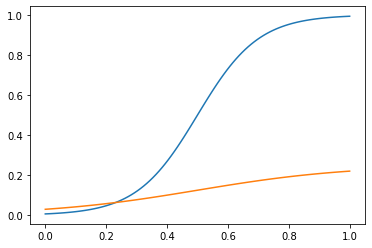

In [11]:
def color_transform(alpha):
#     return 1-((alpha-0.5))**2
    return (np.tanh((alpha-0.5)*5) + 1)/2
#     return 2**2*((alpha - 0.5)**3 + 0.5**3)

def alpha_transform(alpha):
#     return (alpha-0.5)**2
    return (np.tanh((alpha-0.5)*2) + 1)/8


plt.plot(_asdf, color_transform(_asdf))
plt.plot(_asdf, alpha_transform(_asdf))

sigma = 1/15
sigma_y = 1/15


gaussian_kernel = np.exp(-(_kx**2 + _kz**2) / (2 * sigma**2) - _ky**2 / (2 * sigma_y**2))
gaussian_kernel /= np.sum(gaussian_kernel)

In [12]:
np.min(delta)

-1.0

-0.00019368501724035265 0.003942383552296339


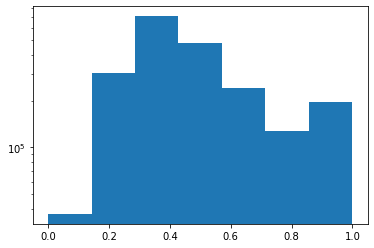

In [13]:
delta_k_blurred = np.fft.rfftn(delta) *  gaussian_kernel

delta_blurred   = np.fft.irfftn(delta_k_blurred)
delta_blurred *= WLIM.reshape(1, -1, 1)

print(np.min(delta_blurred), np.max(delta_blurred))

denom = -np.min(delta_blurred)

raw = delta_blurred/denom
#set up so that white is at 0.5
trans_raw = (raw-np.min(raw)) / (-2*(np.min(raw)))
trans_raw = np.where(trans_raw >= 1, 1, trans_raw)

plt.hist(trans_raw.flatten(), bins=7)
plt.yscale('log')

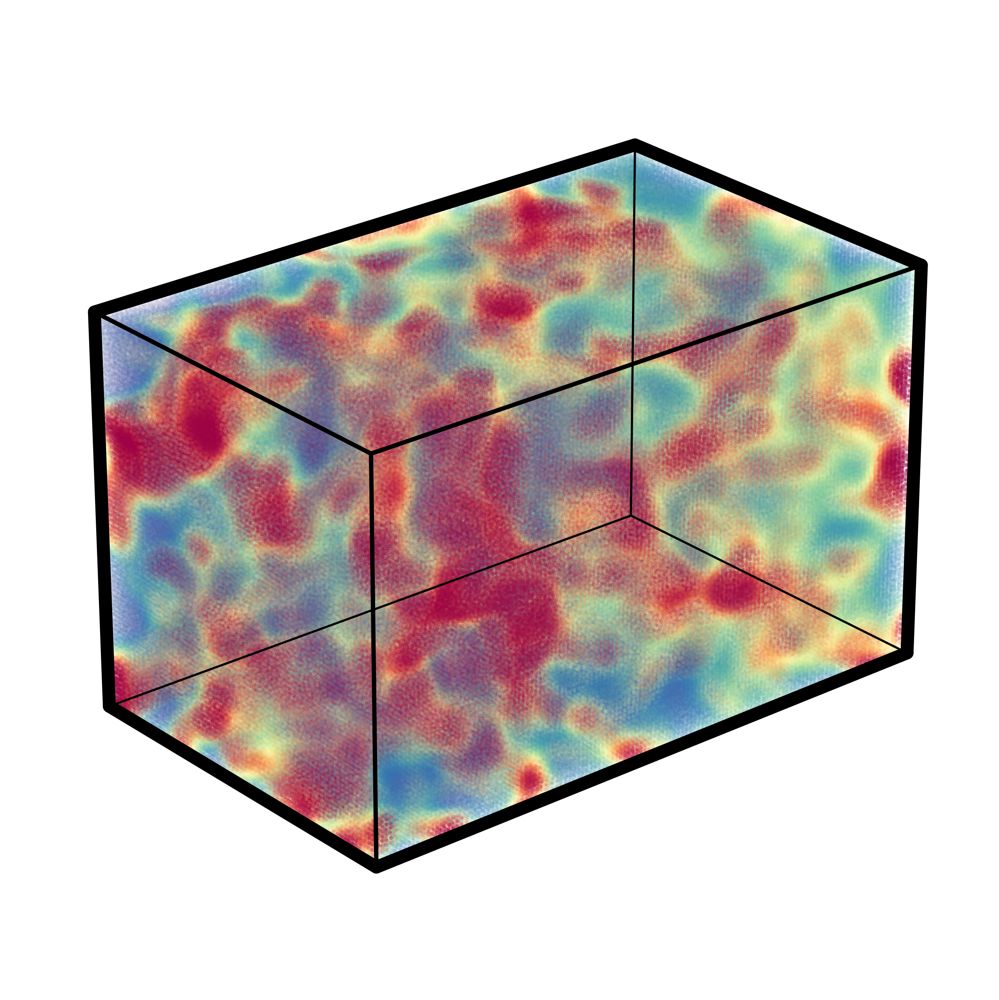

In [14]:


cmap = sns.color_palette("Spectral_r", as_cmap=True)
_colors = color_transform(trans_raw)# + np.random.normal(scale=0.1, size=trans_raw.shape)
_colors = np.where(_colors<0, 0, _colors)
_colors = np.where(_colors >1, 1, _colors)
colors = cmap(_colors)
colors[...,3] = alpha_transform(trans_raw)



fig, ax = _plot(colors)

fig.savefig('figures/016.004.LIM_viz_Nmesh_%d_snapno_%d.png'%(Nmesh, snapno))#, bbox_inches='tight', pad_inches=0)
fig.savefig('figures/016.004.LIM_viz_Nmesh_%d_snapno_%d_lowres.png'%(Nmesh, snapno), dpi=200)#, bbox_inches='tight', pad_inches=0)

In [15]:
np.min(delta_blurred), np.max(delta_blurred)

(-0.00019368501724035265, 0.003942383552296339)

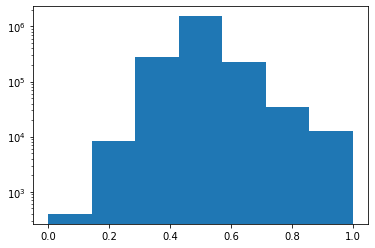

In [16]:
delta_k_blurred_Hi = np.fft.rfftn(delta_blurred) *  _filter
Hi   = np.fft.irfftn(delta_k_blurred_Hi)

raw = Hi/denom
#set up so that white is at 0.5
trans_raw = (raw-np.min(raw)) / (-2*(np.min(raw)))
trans_raw = np.where(trans_raw >= 1, 1, trans_raw)
plt.hist(trans_raw.flatten(), bins=7)
plt.yscale('log')


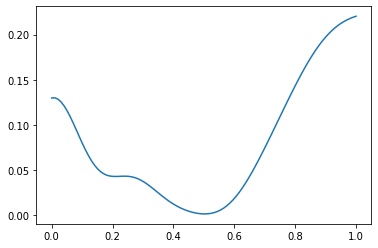

In [17]:

def alpha_transform(alpha):
#     return (alpha-0.5)**2
    return (np.tanh((alpha-0.5)*2) + 1)/8 * (1-np.sinc(2*(alpha-0.5))**2) + np.sinc(5*alpha)**2/10

cmap = sns.color_palette("Spectral_r", as_cmap=True)
_colors = color_transform(trans_raw)# + np.random.normal(scale=0.1, size=trans_raw.shape)
_colors = np.where(_colors<0, 0, _colors)
_colors = np.where(_colors >1, 1, _colors)
colors = cmap(_colors)
colors[...,3] = alpha_transform(trans_raw)
plt.plot(_asdf, alpha_transform(_asdf))

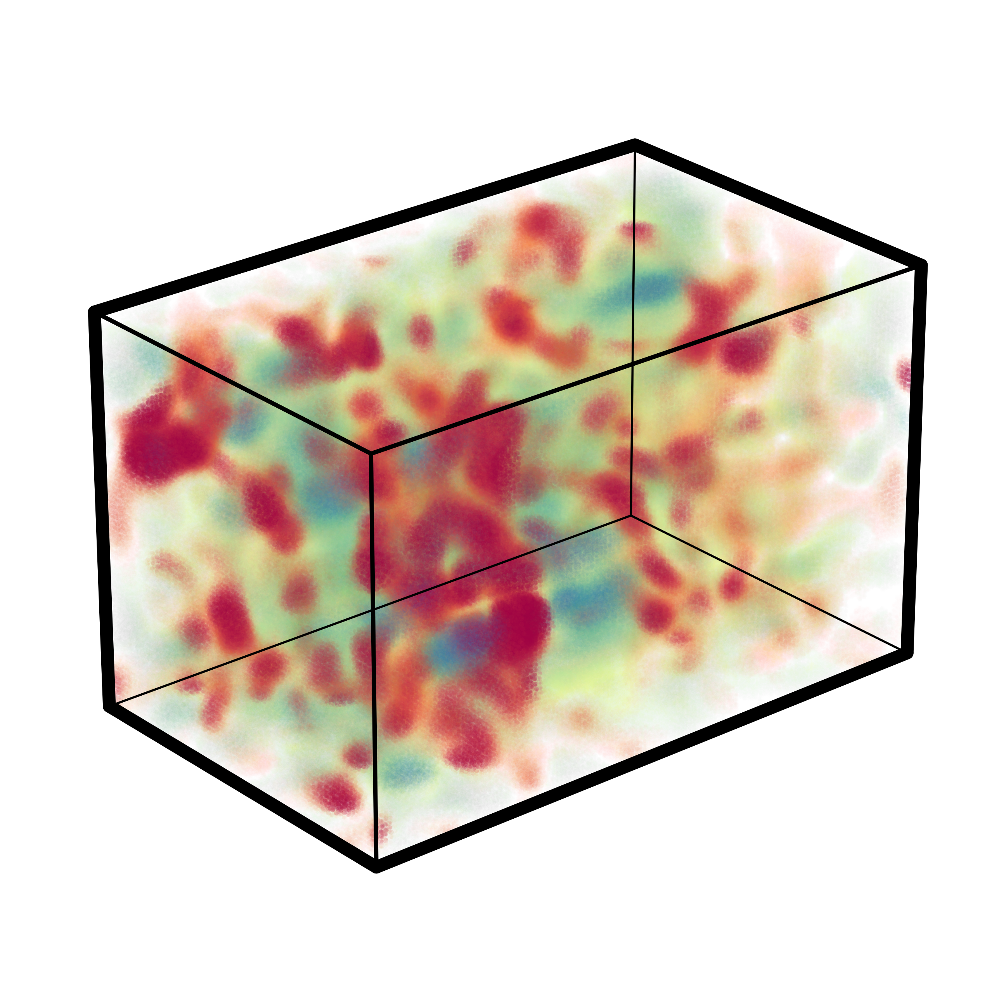

In [18]:
fig, ax = _plot(colors, sz=0.33)

fig.savefig('figures/016.004.LIM_viz_Nmesh_%d_snapno_%d_Hi.png'%(Nmesh, snapno))#, bbox_inches='tight', pad_inches=0)
fig.savefig('figures/016.004.LIM_viz_Nmesh_%d_snapno_%d_Hi_lowres.png'%(Nmesh, snapno), dpi=200)#, bbox_inches='tight', pad_inches=0)


# foregrounds

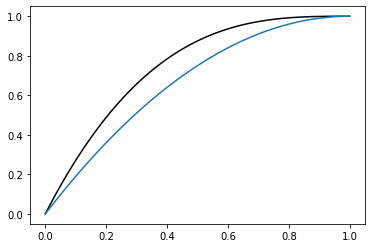

In [19]:
plt.plot(_asdf, 1-(np.abs(_asdf-1))**3, c='k')
plt.plot(_asdf, 1-((_asdf-1))**2)

In [20]:
np.min(dfg), np.max(dfg)

(-0.017314706, 2.0000002)

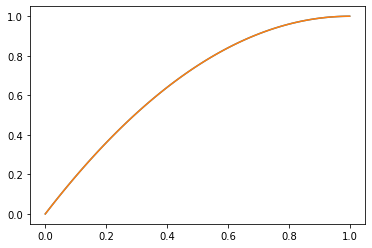

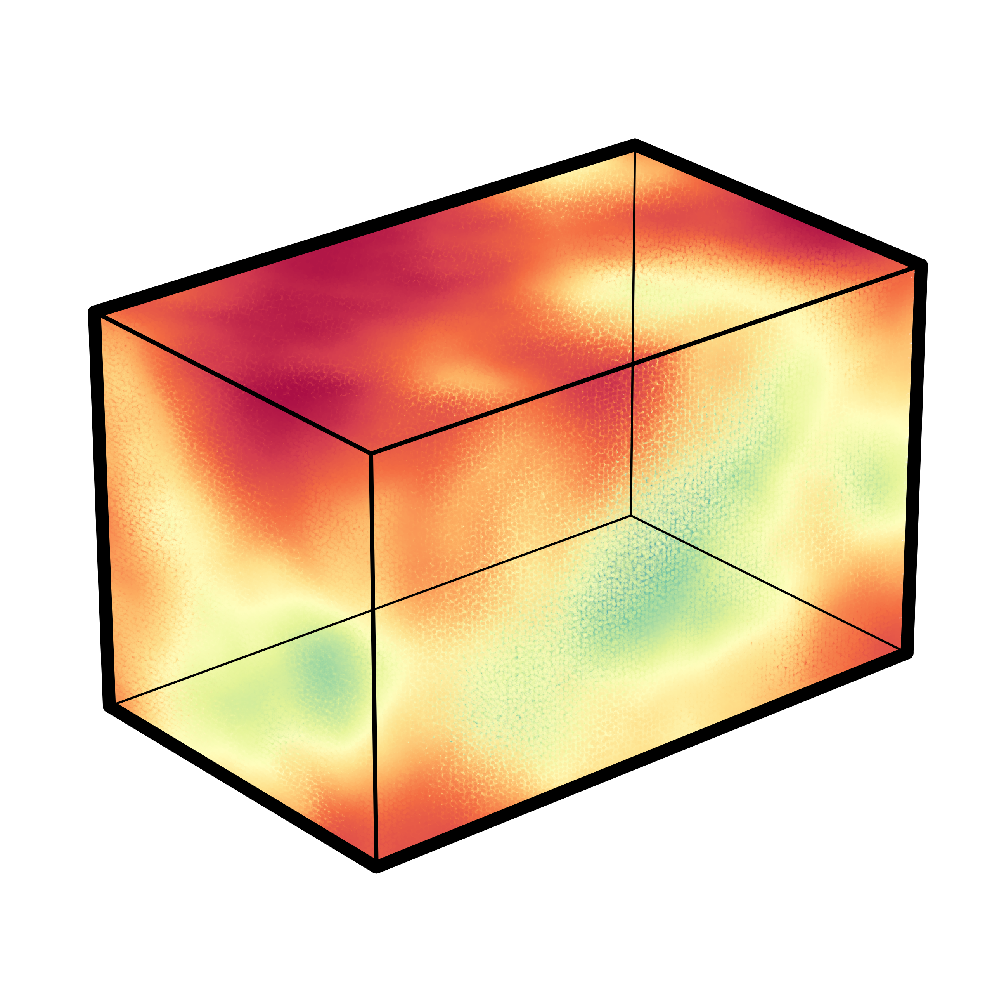

In [21]:
def color_transform(alpha):
    return 1-((alpha-1))**2
#     return alpha**2

def alpha_transform(alpha):
    return 1-((alpha-1))**2
#     return alpha**2.5

plt.plot(_asdf, color_transform(_asdf))
plt.plot(_asdf, alpha_transform(_asdf))

pseudo_fg_k = np.fft.rfftn(dfg)
pseudo_fg   = np.fft.irfftn(pseudo_fg_k)
pseudo_fg   = np.where(pseudo_fg < 0, 0, pseudo_fg)

cmap = sns.color_palette("Spectral_r", as_cmap=True)
# cmap = sns.cubehelix_palette(start=np.linspace(0,3,10)[-1], light=0.88, as_cmap=True)
# cmap = sns.color_palette("crest", as_cmap=True)

colors = np.ones((Nmesh,Nmesh,Nmesh,)+ (4,))

denom = (np.max(pseudo_fg))
alph = np.where(pseudo_fg / denom <= 1, pseudo_fg / denom, 1)

colors = cmap(color_transform(alph))
colors[...,3] = alpha_transform(alph)


fig, ax = _plot(colors, nstd=7)

fig.savefig('figures/016.004.LIM_viz_Nmesh_%d_snapno_%d_fg.png'%(Nmesh, snapno))#, bbox_inches='tight', pad_inches=0)
fig.savefig('figures/016.004.LIM_viz_Nmesh_%d_snapno_%d_fg_lowres.png'%(Nmesh, snapno), dpi=200)#, bbox_inches='tight', pad_inches=0)

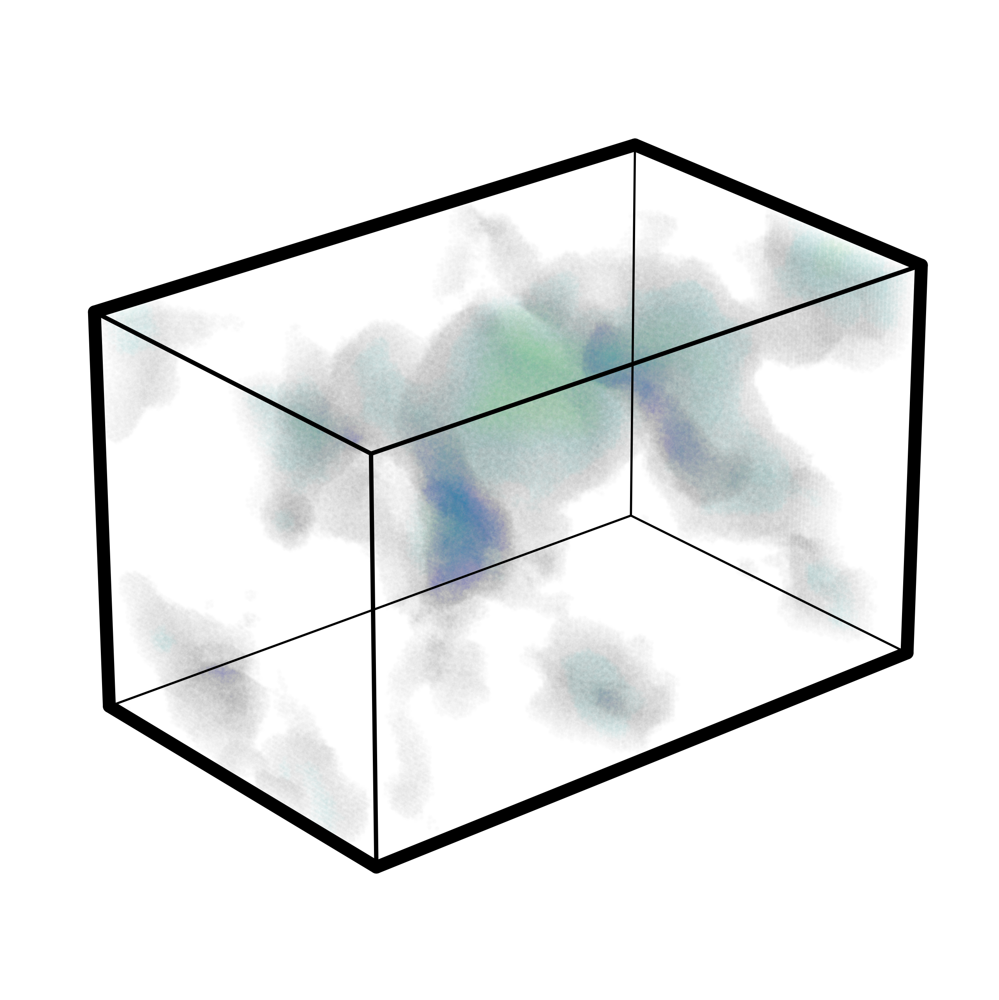

In [22]:
def alpha_transform(alpha):
    return alpha**2

pseudo_fg_k_blurred_Hi = pseudo_fg_k *  _filter
fg_Hi   = np.fft.irfftn(pseudo_fg_k_blurred_Hi)
fg_Hi   = np.where(fg_Hi < 0, 0, fg_Hi)


cmap = sns.color_palette("Spectral_r", as_cmap=True)
# cmap = sns.cubehelix_palette(start=np.linspace(0,3,10)[-1], light=0.88, as_cmap=True)

colors = np.ones((Nmesh,Nmesh,Nmesh,)+ (4,))

denom = (np.max(pseudo_fg))
alph = np.where(fg_Hi / denom <= 1, fg_Hi / denom, 1)

colors = cmap(color_transform(alph))
colors[...,3] = alpha_transform(alph)


fig, ax = _plot(colors, nstd=7)
fig.savefig('figures/016.004.LIM_viz_Nmesh_%d_snapno_%d_fg_HI.png'%(Nmesh, snapno))#, bbox_inches='tight', pad_inches=0)
fig.savefig('figures/016.004.LIM_viz_Nmesh_%d_snapno_%d_fg_HI_lowres.png'%(Nmesh, snapno), dpi=200)#, bbox_inches='tight', pad_inches=0)

# cross correlation

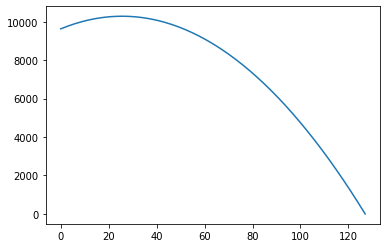

In [23]:
source = 8*Nmesh


# basically CMB source at x=8
# and this LIM experiment probes from x=3.8-4.8
lensing_kernel = -(((source*3.8/8+np.arange(Nmesh)) - source/2)**2)
lensing_kernel -= np.min(lensing_kernel)

plt.plot(np.arange(Nmesh), lensing_kernel)

In [24]:
#project delta, not 1+delta
proj = np.sum( (df-1) * lensing_kernel.reshape(1, -1, 1), axis=1)

In [25]:
# pvt = 0.5

# def alpha_transform(trans_raw):
#     poww = 1.5
#     ret = (np.abs(trans_raw-pvt)**poww)/np.abs(np.abs(1-pvt)**poww)
#     return ret 

# def color_transform(trans_raw):
#     return (np.tanh((trans_raw-pvt) * 5)+1)/2

# def color_transform(alpha):
#     return 1-((alpha-1))**2
# #     return (np.tanh((alpha-0.5)*5) + 1)/2

# def alpha_transform(alpha):
#     return alpha**2.5


# plt.plot(_asdf, alpha_transform(_asdf))
# plt.plot(_asdf, color_transform(_asdf))

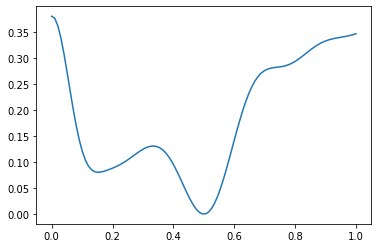

In [26]:
def color_transform(alpha):
#     return 1-((alpha-0.5))**2
    return (np.tanh((alpha-0.5)*5) + 1)/2
#     return 2**2*((alpha - 0.5)**3 + 0.5**3)

# def alpha_transform(alpha):
# #     return (alpha-0.5)**2
#     return (np.tanh((alpha-0.5)*2) + 1)/8

def alpha_transform(alpha):
#     return (alpha-0.5)**2 * 4
    return (np.tanh((alpha-0.5)*2) + 1)/5 * (1-np.sinc(5*(alpha-0.5))**2) + np.sinc(5*alpha)**4/3


plt.plot(_asdf, alpha_transform(_asdf))
# plt.plot(_asdf, color_transform(_asdf))

In [27]:
delta_blurred_times_proj = delta_blurred * proj.reshape(Nmesh, 1, Nmesh)


cmap = sns.color_palette("Spectral_r", as_cmap=True)
colors = np.ones((Nmesh,Nmesh,Nmesh,)+ (4,))

denom = -np.min(delta_blurred_times_proj)

raw = delta_blurred_times_proj/denom
#set up so that white is at 0.5
trans_raw = (raw-np.min(raw)) / (-2*(np.min(raw)))
trans_raw = np.where(trans_raw >= 1, 1, trans_raw)


_colors = color_transform(trans_raw)# + np.random.normal(scale=0.1, size=trans_raw.shape)
_colors = np.where(_colors<0, 0, _colors)
_colors = np.where(_colors >1, 1, _colors)
colors = cmap(_colors)
colors[...,3] = alpha_transform(trans_raw)

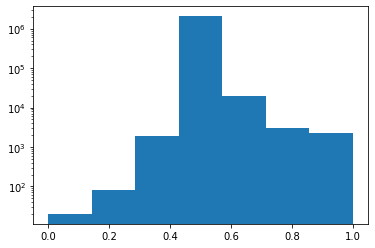

In [28]:
plt.hist(trans_raw.flatten(), bins=7)
plt.yscale('log')

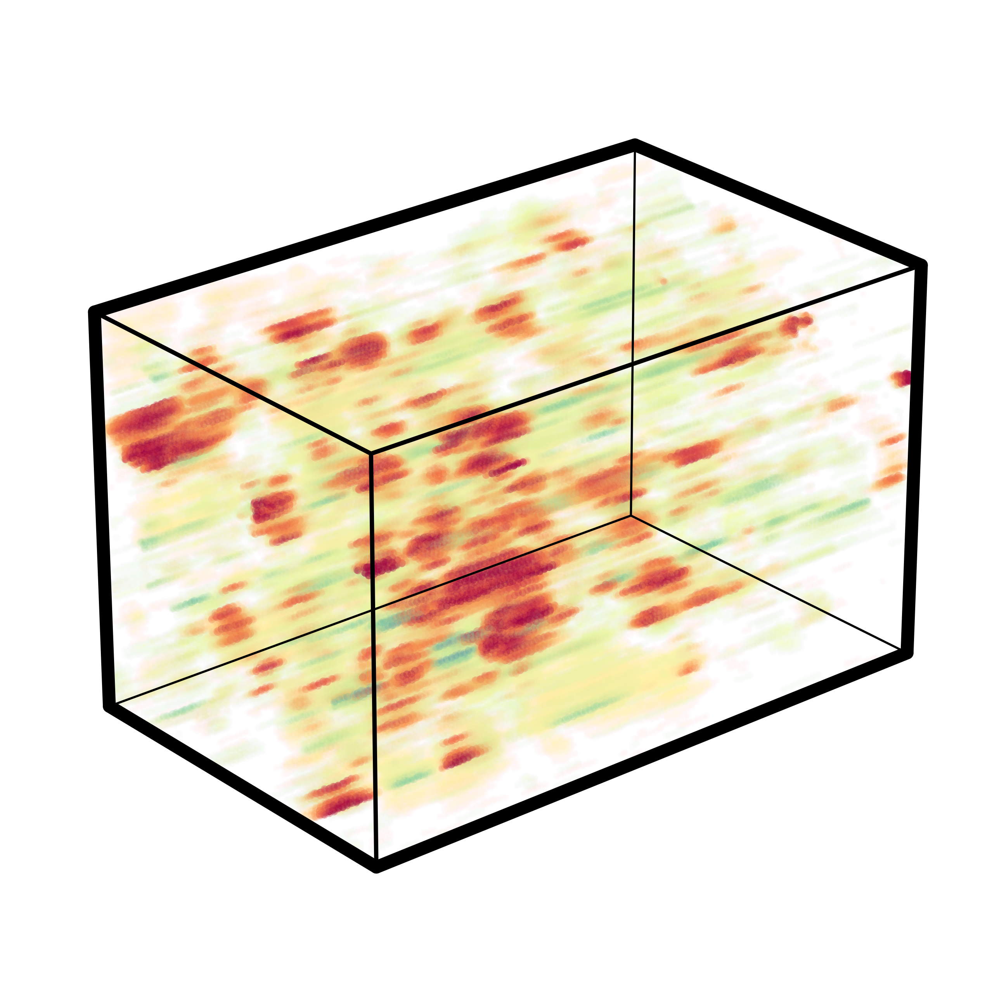

In [29]:
fig, ax = _plot(colors, sz=0.5, nstd=8)

fig.savefig('figures/016.004.LIM_viz_Nmesh_%d_snapno_%d_LIM_times_proj.png'%(Nmesh, snapno))#, bbox_inches='tight', pad_inches=0)
fig.savefig('figures/016.004.LIM_viz_Nmesh_%d_snapno_%d_LIM_times_proj_lowres.png'%(Nmesh, snapno), dpi=200)#, bbox_inches='tight', pad_inches=0)

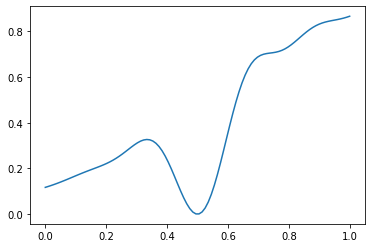

In [30]:


def alpha_transform(alpha):
#     return (alpha-0.5)**2 * 4
    return (np.tanh((alpha-0.5)*2) + 1)/2 * (1-np.sinc(5*(alpha-0.5))**2) #+ np.sinc(5*alpha)**4/3


plt.plot(_asdf, alpha_transform(_asdf))

In [31]:
Hi_kap = Hi * proj.reshape(Nmesh, 1, Nmesh)

colors = np.ones((Nmesh,Nmesh,Nmesh,)+ (4,))

raw = Hi_kap/denom
#set up so that white is at 0.5
trans_raw = (raw-np.min(raw)) / (-2*(np.min(raw)))
trans_raw = np.where(trans_raw >= 1, 1, trans_raw)


_colors = color_transform(trans_raw)# + np.random.normal(scale=0.1, size=trans_raw.shape)
_colors = np.where(_colors<0, 0, _colors)
_colors = np.where(_colors >1, 1, _colors)
colors = cmap(_colors)
colors[...,3] = alpha_transform(trans_raw)

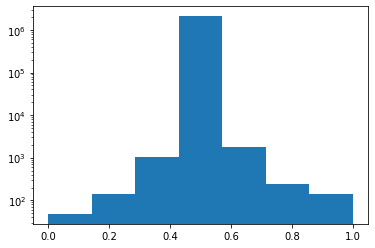

In [32]:
plt.hist(trans_raw.flatten(), bins=7)
plt.yscale('log')

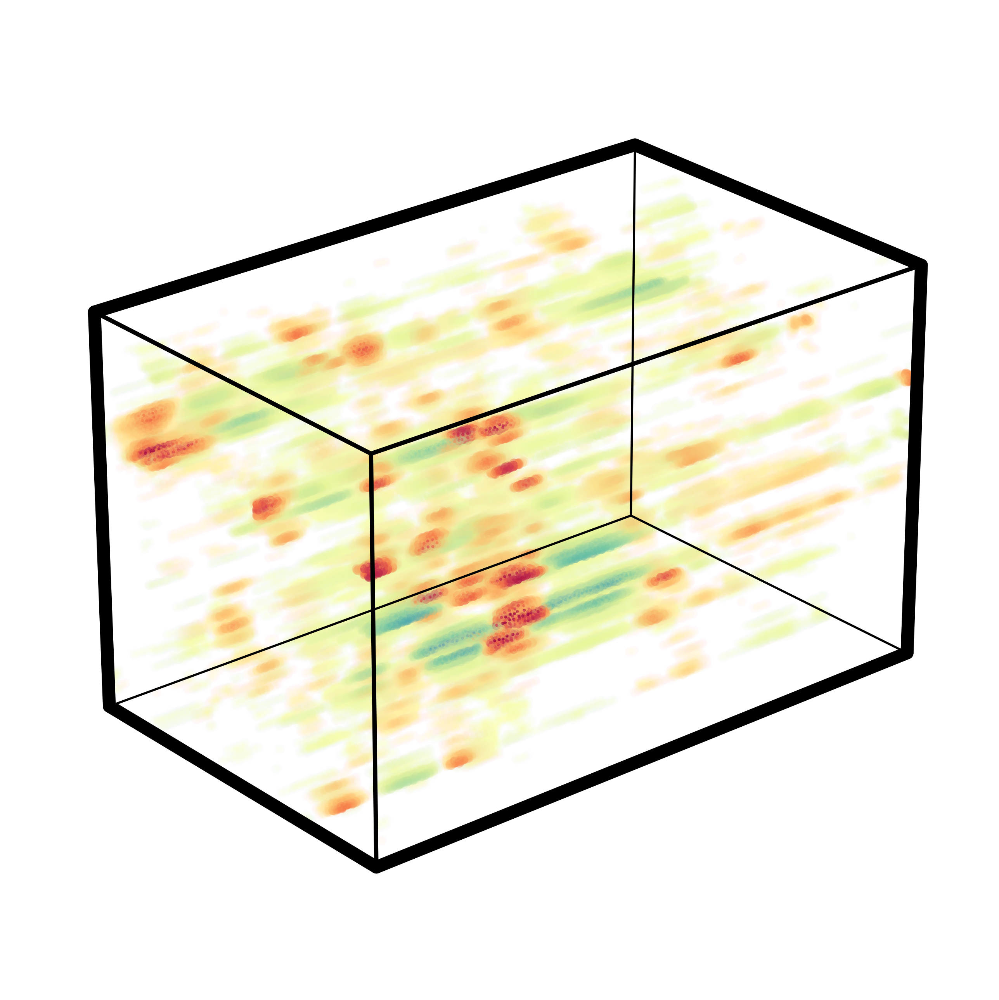

In [33]:
fig, ax = _plot(colors, sz=0.5, nstd=13)
fig.savefig('figures/016.004.LIM_viz_Nmesh_%d_snapno_%d_LIM_HI_times_proj.png'%(Nmesh, snapno))#, bbox_inches='tight', pad_inches=0)
fig.savefig('figures/016.004.LIM_viz_Nmesh_%d_snapno_%d_LIM_HI_times_proj_lowres.png'%(Nmesh, snapno), dpi=200)#, bbox_inches='tight', pad_inches=0)